# Proyecto: clustering de imágenes

Este proyecto consiste en llevar a cabo un clustering de imágenes, utilizando autoencoders convolucionales. Las imágenes fueron descargadas desde https://users.dcc.uchile.cl/%7Epguerrer/images.tar.gz.

## Cargar librerías y datos

In [3]:
import numpy as np
np.random.seed(42)
import tensorflow as tf
tf.set_random_seed(42)

import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import pandas as pd
import re
import time

from keras.models import Sequential, Model, load_model
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, GlobalAveragePooling2D, UpSampling2D, AveragePooling2D
from keras.optimizers import RMSprop
from keras.applications.vgg16 import VGG16
from keras import backend as K
from PIL import Image
from pandas.plotting import table
from sklearn.cluster import KMeans

# Importar seaborn para gráficar
import seaborn as sns
sns.set(color_codes=True, rc={'figure.figsize':(9, 6)})
sns.set_context("talk")

A continuación, se extraen los metadatos de las imágenes del dataset, tales como el ancho, alto, área, formato de la imagen, modo (RGB, escala de grises, etc.) y tamaño en kB. Este paso tomó cierto tiempo, por lo que sólo se ejecutó una vez y el resultado se guardó en el archivo metadatos.csv

In [32]:
# Guardar metadatos de las imágenes
dir = os.listdir("../Datos/images")

filename = []
height = []
img_format = []
img_mode = []
size = []
width = []

for image in dir:
    img = Image.open("../Datos/images/" + image)
    filename.append(re.sub('../Datos/images/', '', img.filename))
    height.append(img.height)
    img_format.append(img.format)
    img_mode.append(img.mode)
    size.append(os.stat('../Datos/images/' + image).st_size / 1000.)
    width.append(img.width)

'\n# Guardar metadatos de las im\xc3\xa1genes\ndir = os.listdir("../Datos/images")\n\nfilename = []\nheight = []\nimg_format = []\nimg_mode = []\nsize = []\nwidth = []\n\nfor image in dir:\n    img = Image.open("../Datos/images/" + image)\n    filename.append(re.sub(\'../Datos/images/\', \'\', img.filename))\n    height.append(img.height)\n    img_format.append(img.format)\n    img_mode.append(img.mode)\n    size.append(os.stat(\'../Datos/images/\' + image).st_size / 1000.)\n    width.append(img.width)\n'

In [33]:
# Guardar metadatos como CSV
df = pd.DataFrame({'filename': filename, 'width': width, 'height': height, 'size': size, 'img_format': img_format, 'img_mode': img_mode})
df.to_csv('metadatos.csv', index=False)
df.head()

"\n# Guardar metadatos como CSV\ndf = pd.DataFrame({'filename': filename, 'width': width, 'height': height, 'size': size, 'img_format': img_format, 'img_mode': img_mode})\ndf.to_csv('metadatos.csv', index=False)\ndf.head()\n"

In [5]:
# Cargar csv con metadatos
df = pd.read_csv('metadatos.csv')
df['area'] = df['height'] * df['width']
total_imgs = df.shape[0]
print("Total de imágenes: {}".format(total_imgs))
df.head()

Total de imágenes: 11131


,filename,height,img_format,img_mode,size,width,area
0,FPEG_FEG2443_07f942c9-b700-4bff-8773-5ce637c20...,960,JPEG,RGB,77.201,1280,1228800
1,3956919_2xk4enj0ulg.jpg,900,JPEG,RGB,66.236,1200,1080000
2,3770755_aqm5w1u0dfn.jpg,480,JPEG,RGB,51.969,640,307200
3,PMPI_18971_18971-1_1288858.JPG,960,JPEG,RGB,24.657,470,451200
4,3952912_r3kk4cvbdwd.jpg,480,JPEG,RGB,27.864,640,307200


## Análisis exploratorio de datos

A continuación, se muestra un análisis estadísticos de los datos:

In [6]:
df.describe()

,height,size,width,area
count,11131.000000,11131.000000,11131.000000,1.113100e+04
mean,839.124427,74.125721,1107.542000,9.696494e+05
std,181.860171,47.436370,256.681227,3.514433e+05
min,192.000000,5.334000,280.000000,5.880000e+04
25%,768.000000,39.061000,960.000000,6.912000e+05
50%,960.000000,62.885000,1280.000000,1.228800e+06
75%,960.000000,96.805000,1280.000000,1.228800e+06
max,960.000000,327.594000,1280.000000,1.228800e+06


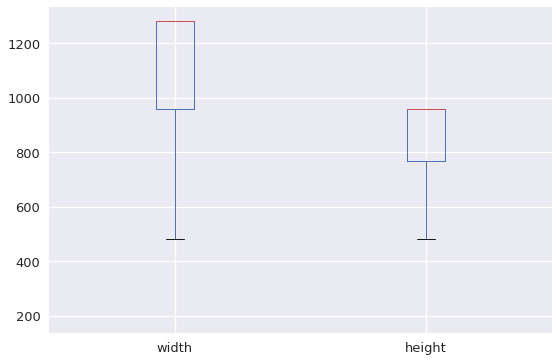

In [7]:
plt.subplots()
df.boxplot(column=['width', 'height']);

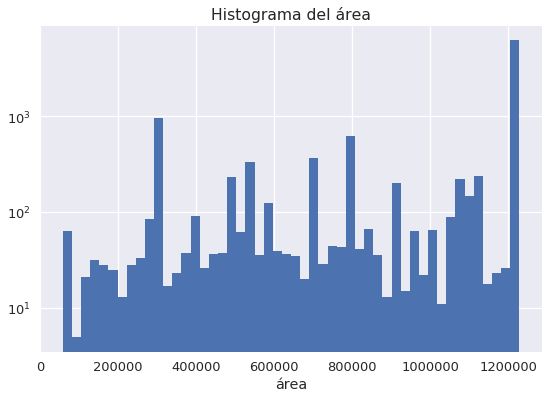

In [8]:
fig, ax = plt.subplots()
df['area'].hist(bins=50)
ax.set_title(u'Histograma del área')
ax.set_xlabel(u'área')
ax.set_yscale('log')

El dataset sólo contiene imágenes en RGB y escala de grises. Estudiemos las imágenes en escala de grises:

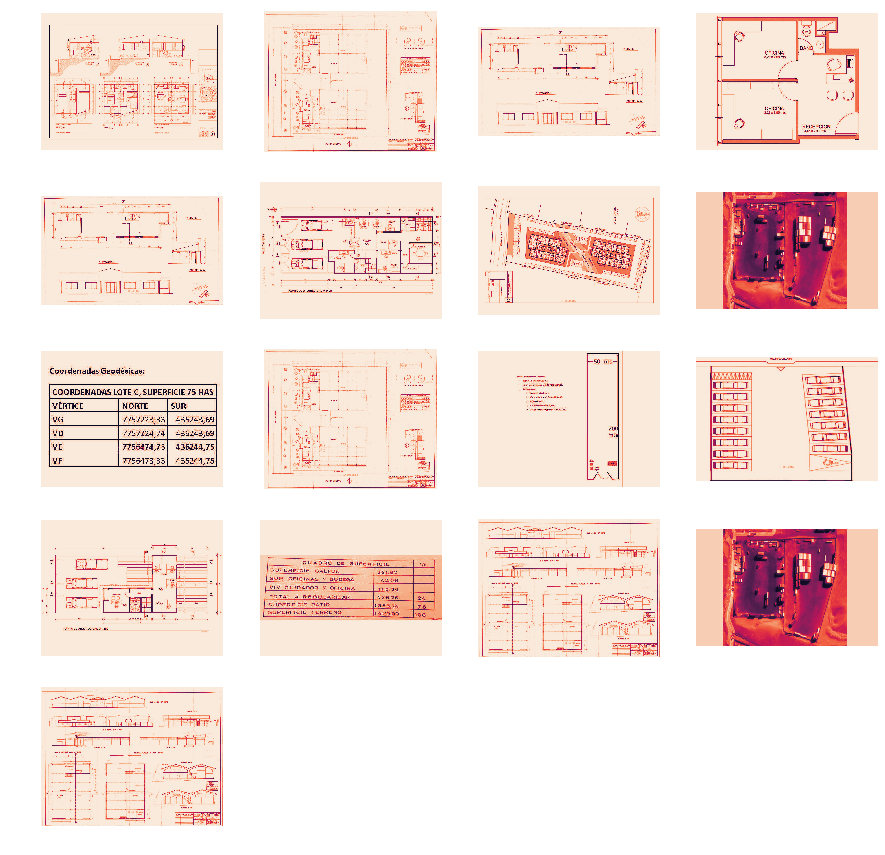

In [11]:
greyscale = list(df[df['img_mode'] == 'L'].filename)

columns = 4
images = []
for filename in greyscale:
    images.append(mpimg.imread("../Datos/images/" + filename))
    
fig, ax = plt.subplots(figsize = (15, 15))
for i, image in enumerate(images):
    plt.subplot(1.0 * len(images) / columns + 1, columns, i + 1)
    plt.axis('off')
    plt.imshow(image)

Se eliminan las imágenes en escala de grises, ya que corresponden a planos de las casas y no son relevantes para el análisis

In [12]:
df = df[df['img_mode'] != 'L']
print("Número de imágenes: {} de un total de {}".format(df.shape[0], total_imgs))

Número de imágenes: 11114 de un total de 11131


Para poder escalar las imágenes a un formato estándar, sólo se considerará aquellas que tienen un aspect ratio de 4:3.

In [13]:
df = df[(df.width > df.height) & (1.0 * df.width / df.height - 1.33333 < 0.001)]
print("Número de imágenes con aspecto 4:3 --> {} de un total de {}".format(df.shape[0], total_imgs))

Número de imágenes con aspecto 4:3 --> 9645 de un total de 11131


In [11]:
df.describe()

,height,size,width,area
count,9645.000000,9645.000000,9645.000000,9.645000e+03
mean,844.218663,77.106241,1125.108657,9.945365e+05
std,183.221754,49.007827,244.178796,3.534168e+05
min,210.000000,5.334000,280.000000,5.880000e+04
25%,768.000000,40.255000,1024.000000,7.864320e+05
50%,960.000000,66.055000,1280.000000,1.228800e+06
75%,960.000000,101.450000,1280.000000,1.228800e+06
max,960.000000,327.594000,1280.000000,1.228800e+06


Analizamos las imágenes más pequeñas:

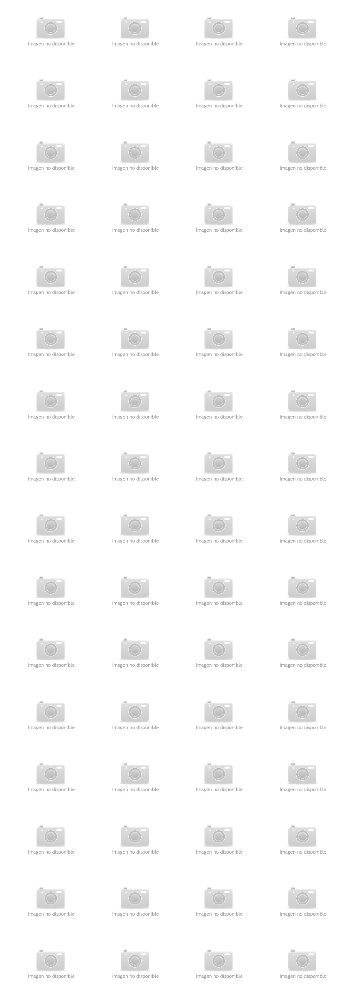

In [14]:
# Mostrar imágenes más pequeñas
df_280 = df[(df.width == 280) & (df.height == 210)]
columns = 4
images = []
for filename in df_280.filename:
    images.append(mpimg.imread("../Datos/images/" + filename))
    
fig, ax = plt.subplots(figsize = (15, 50))
for i, image in enumerate(images):
    plt.subplot(1.0 * len(images) / columns + 1, columns, i + 1)
    plt.axis('off')
    plt.imshow(image)

In [15]:
# Eliminar estas imágenes
df = df[df.width != 280]
print("Número de imágenes: {} de un total de {}".format(df.shape[0], total_imgs))

Número de imágenes: 9581 de un total de 11131


Vamos a redimensionar las imágenes a una resolución de 320x240, para reducir el costo computacional de la red convolucional. Para esto, se define la función *process_images*:

In [16]:
# Cargar datos y redimensionar
def process_images(df, shape=(320, 240)):
    '''
    Retorna una lista X con las imágenes redimensionadas y normalizadas
    '''
    X = []
    # Cargar imágenes
    for filename in df.filename:
        X.append(cv2.resize(cv2.imread("../Datos/images/" + filename), shape))
    # Normalizar
    X = np.asarray(X)/255.
    
    return X

## Autoencoders

La implementación de *autoencoders* se sacó del sitio http://maxcalabro.com/clustering-images-with-autoencoders-and-attention-maps/ y se adaptó para los datos del proyecto. La siguiente función permite dividir el dataset en *batches*, ya que no se puede utilizar todos los datos a la vez en el entrenamiento debido a limitaciones de memoria.

In [21]:
def get_batches(df, batch_size=10000):
    if len(df) < batch_size:
        return [df]
    
    n_batches = len(df) // batch_size

    # If batches fit exactly into the size of df.
    if len(df) % batch_size == 0:
        return [df[i*batch_size:(i+1)*batch_size] for i in range(n_batches)]
    
    # If there is a remainder.
    else:
        return [df[i*batch_size:min((i+1)*batch_size, len(df))] for i in range(n_batches+1)]

La siguiente función lleva a cabo el entrenamiento de la red convolucional. Recibe como input el modelo, el dataset, la cantidad de épocas, el tamaño de cada *batch* y el tamaño de la imagen (en nuestro caso, 320x240). Retorna las métricas obtenidas en el entrenamiento. 

In [17]:
def fit_auto(model, df_train, epochs=1, df_batch_size=10000, model_batch_size=100, image_size=(320, 240)):
    print('Training on {} examples.'.format(len(df_train)))
    
    # We have to run epochs one at a time -- each epoch we'll evaluate the val set.
    for i in range(epochs):
        
        print('\nStarting Epoch {} of {}.'.format(i+1, epochs))
        
        # In each epoch, we'll run the model on each of the batches.
        for batch in get_batches(df_train, df_batch_size):
            X = process_images(batch, image_size)
            model.fit(X, X,
                      batch_size=model_batch_size,
                      epochs=1,
                      verbose=1)

    score = model.evaluate(X, X, verbose=1)
    
    print('Test loss:', score[0])
    print('Test accuracy:', score[1])
    
    return score

A continuación, se define la arquitectura de la red. Esta se compone de capas convolucionales y de pooling. La función de pérdida utilizada es entropía cruzada binaria y el optimizador es *adadelta*.

In [18]:
auto_model = Sequential()

# First we'll encode the image by downsampling using Conv2D and MaxPooling layers.

auto_model.add(Conv2D(32, kernel_size=(3, 3),
               activation='relu',
               input_shape=(240, 320, 3),
               padding='same'))

auto_model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
auto_model.add(Conv2D(16, kernel_size=(3, 3), activation='relu', padding='same'))
auto_model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
auto_model.add(Conv2D(8, kernel_size=(3, 3), activation='relu', padding='same'))
auto_model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))

# Encoding finished, starting decoding, using UpSampling layers.

auto_model.add(Conv2D(8, kernel_size=(3, 3), activation='relu', padding='same'))
auto_model.add(UpSampling2D((2, 2)))
auto_model.add(Conv2D(16, kernel_size=(3, 3), activation='relu', padding='same'))
auto_model.add(UpSampling2D((2, 2)))
auto_model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', padding='same'))
auto_model.add(UpSampling2D((2, 2)))
auto_model.add(Conv2D(3, kernel_size=(1, 1), activation='sigmoid'))

auto_model.summary()

auto_model.compile(loss='binary_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 240, 320, 32)      896       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 120, 160, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 120, 160, 16)      4624      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 60, 80, 16)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 60, 80, 8)         1160      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 30, 40, 8)         0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 30, 40, 8)         584       
__________

Vemos que la red se compone de capas convolucionales y de pooling alternadas. Además, se muestra el tamaño del output de cada capa y la cantidad de parámetros involucrados en cada paso. El total de parámetros a aprender es 13171. La capa intermedia (que se utilizará como la representación codificada de cada imagen) es de tamaño 30x40 y tiene 8 canales.

## Ejemplo con 12 imágenes

A continuación, se muestra un ejemplo de entrenamiento de la red con 12 imágenes.

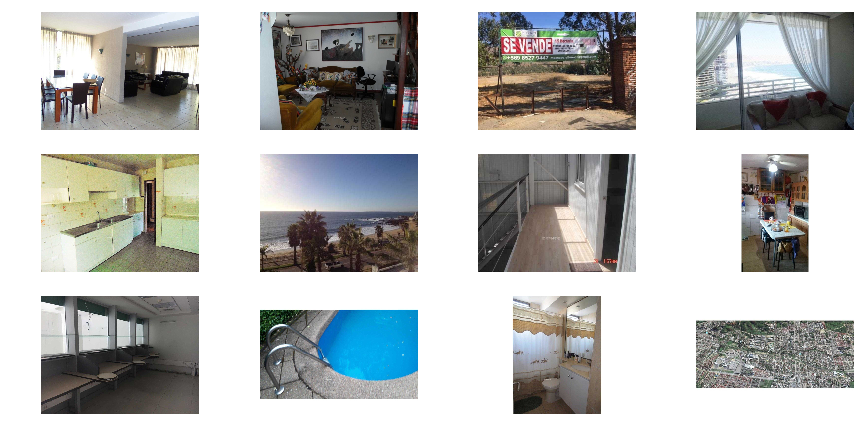

In [22]:
n = 12
df_train = df.iloc[:n, :]
img_train = process_images(df_train)

# Mostrar imágenes
fig, ax = plt.subplots(figsize = (15, 10))
for i, image in enumerate(img_train):
    plt.subplot(1.0 * len(img_train) / columns + 1, columns, i + 1)
    plt.axis('off')
    plt.imshow(image[:,:,::-1])

In [25]:
# Entrenar la red convolucional
score = fit_auto(auto_model,
                 df_train,
                 epochs=10)

Training on 12 examples.

Starting Epoch 1 of 10.
Epoch 1/1
12/12 [==============================] - 2s 132ms/step - loss: 0.6499 - acc: 0.1456

Starting Epoch 2 of 10.
Epoch 1/1
12/12 [==============================] - 2s 138ms/step - loss: 0.6492 - acc: 0.1456

Starting Epoch 3 of 10.
Epoch 1/1
12/12 [==============================] - 2s 135ms/step - loss: 0.6541 - acc: 0.1456

Starting Epoch 4 of 10.
Epoch 1/1
12/12 [==============================] - 1s 124ms/step - loss: 0.6456 - acc: 0.1456

Starting Epoch 5 of 10.
Epoch 1/1
12/12 [==============================] - 2s 130ms/step - loss: 0.6451 - acc: 0.1456

Starting Epoch 6 of 10.
Epoch 1/1
12/12 [==============================] - 2s 129ms/step - loss: 0.6412 - acc: 0.1456

Starting Epoch 7 of 10.
Epoch 1/1
12/12 [==============================] - 2s 128ms/step - loss: 0.6557 - acc: 0.1456

Starting Epoch 8 of 10.
Epoch 1/1
12/12 [==============================] - 2s 127ms/step - loss: 0.6442 - acc: 0.1456

Starting Epoch 9 of 10

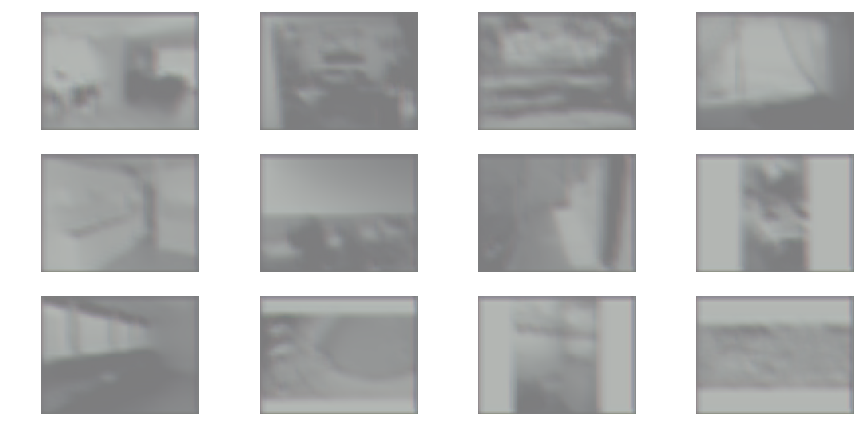

In [26]:
# Visualizar output de la red
im_decoded = auto_model.predict(img_train)

fig, ax = plt.subplots(figsize = (15, 10))
for i, image in enumerate(im_decoded):
    plt.subplot(1.0 * len(im_decoded) / columns + 1, columns, i + 1)
    plt.axis('off')
    plt.imshow(image[:,:,::-1])

Vemos que el *output* de la red es una reconstrucción de las imágenes originales, pero con información que se perdió en el proceso.

## Entrenamiento con el dataset completo

Luego, se ejecutó el mismo proceso con las 9581 imágenes del dataset, en batches de tamaño 100 (la memoria no era suficiente para batches de mayor tamaño). Este paso tomó un tiempo considerable, por lo que sólo se ejecutó una vez. El resultado del entrenamiento se guardó en el archivo "auto_model_compressed.h5". Por este motivo, la siguiente celda se encuentra comentada y sólo se carga el modelo. 

In [27]:
df_train = df

# Entrenar red
start = time.time()

score = fit_auto(auto_model,
                 df_train,
                 epochs=8,
                 df_batch_size=100)

end = time.time()

print("Tiempo de entrenamiento: {} minutos".format((end - start) / 60))

# Guardar el modelo
auto_model.save('auto_model_compressed.h5')

Training on 9581 examples.

Starting Epoch 1 of 8.
Epoch 1/1
100/100 [==============================] - 36s 359ms/step - loss: 0.6362 - acc: 0.1329
Epoch 1/1
100/100 [==============================] - 16s 161ms/step - loss: 0.6291 - acc: 0.1363
Epoch 1/1
100/100 [==============================] - 19s 195ms/step - loss: 0.6553 - acc: 0.1365
Epoch 1/1
100/100 [==============================] - 15s 150ms/step - loss: 0.6315 - acc: 0.1846
Epoch 1/1
100/100 [==============================] - 13s 132ms/step - loss: 0.6741 - acc: 0.1494
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.6153 - acc: 0.1952
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.6176 - acc: 0.1522
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.6394 - acc: 0.1303
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.6481 - acc: 0.1945
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 

Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5212 - acc: 0.1667
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5371 - acc: 0.1271
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5330 - acc: 0.1617
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5466 - acc: 0.1511
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5840 - acc: 0.1799
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.6452 - acc: 0.1600
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5959 - acc: 0.1729
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5292 - acc: 0.1941
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5090 - acc: 0.1995
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5187 - acc: 0.1825
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5211 - acc: 0.1463
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5236 - acc: 0.1310
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5156 - acc: 0.1386
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.4990 - acc: 0.1758
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.4778 - acc: 0.2099
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.4895 - acc: 0.1823
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.4959 - acc: 0.1833
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.5072 - acc: 0.1708
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5306 - acc: 0.1852
Epoch 1/1
100/100 [==============================] - 13s 132ms/step - loss: 0.6102 - acc: 0.1784
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.4930 - acc: 0.1655
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4989 - acc: 0.1673
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5145 - acc: 0.1614
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5321 - acc: 0.1388
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.5193 - acc: 0.1851
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.5440 - acc: 0.1643
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5294 - acc: 0.1729
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5270 - acc: 0.1415
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5214 - acc: 0.1408
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5087 - acc: 0.1481
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5152 - acc: 0.1578
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4950 - acc: 0.1951
Epoch 1/1
100/100 [==============================] - 13s 130ms/step - loss: 0.5035 - acc: 0.1701
Epoch 1/1
100/100 [==============================] - 14s 136ms/step - loss: 0.4782 - acc: 0.2140
Epoch 1/1
100/100 [==============================] - 14s 139ms/step - loss: 0.5242 - acc: 0.1409
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5063 - acc: 0.1671
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5032 - acc: 0.1900
Epoch 1/1
100/100 [==============================] - 13s 133ms/step - loss: 0.5230 - acc: 0.1421
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.5148 - acc: 0.1575
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.5155 - acc: 0.1322
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5012 - acc: 0.1649
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5142 - acc: 0.1503
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.4863 - acc: 0.1805
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.4849 - acc: 0.1798
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.4893 - acc: 0.1881
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.5084 - acc: 0.1438
Epoch 1/1
100/100 [==============================] - 13s 127ms/step - loss: 0.4982 - acc: 0.1576
Epoch 1/1
100/100 [==============================] - 13s 130ms/step - loss: 0.5053 - acc: 0.1538
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.5050 - acc: 0.1487
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.5046 - acc: 0.1581
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.4791 - acc: 0.2271
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.5097 - acc: 0.1613
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.4947 - acc: 0.1754
Epoch 1/1
100/100 [==============================] - 12s 120ms/step - loss: 0.5119 - acc: 0.1444
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.4902 - acc: 0.1768
Epoch 1/1
100/100 [==============================] - 12s 121ms/step - loss: 0.4754 - acc: 0.1898
Epoch 1/1
100/100 [==============================] - 12s 120ms/step - loss: 0.5026 - acc: 0.1395
Epoch 1/1
100/100 [==============================] - 12s 121ms/step - loss: 0.4870 - acc: 0.1794
Epoch 1/1
100/100 [==============================] - 12s 121ms/step - loss: 0.5111 - acc: 0.1398
Epoch 1/1
100/100 [==============================] - 12s 121ms/step - loss: 0.5175 - acc: 0.1511
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4956 - acc: 0.1631
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4882 - acc: 0.1743
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4992 - acc: 0.1543
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.4624 - acc: 0.2082
Epoch 1/1
100/100 [==============================] - 13s 127ms/step - loss: 0.5006 - acc: 0.1413
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.4795 - acc: 0.1847
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.4902 - acc: 0.1735
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.4691 - acc: 0.2053
Epoch 1/1
100/100 [==============================] - 12s 123ms/step - loss: 0.4834 - acc: 0.1650
Epoch 1/1
100/100 [==============================] - 13s 130ms/step - loss: 0.4850 - acc: 0.1564
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5085 - acc: 0.1309
Epoch 1/1
100/100 [==============================] - 12s 125ms/step - loss: 0.4855 - acc: 0.1952
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4948 - acc: 0.1828
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.5090 - acc: 0.1647
Epoch 1/1
100/100 [==============================] - 13s 129ms/step - loss: 0.5246 - acc: 0.1316
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.5204 - acc: 0.1634
Epoch 1/1
100/100 [==============================] - 13s 126ms/step - loss: 0.4939 - acc: 0.1712
Epoch 1/1
100/100 [==============================] - 12s 124ms/step - loss: 0.5078 - acc: 0.1397
Epoch 1/1
100/100 [==============================] - 13s 127ms/step - loss: 0.5068 - acc: 0.1489
Epoch 1/1
100/100 [==============================] - 13s 125ms/step - loss: 0.4946 - acc: 0.1581
Epoch 1/1
100/100 [===========

Epoch 1/1
100/100 [==============================] - 12s 121ms/step - loss: 0.4618 - acc: 0.1997
Epoch 1/1
100/100 [==============================] - 12s 122ms/step - loss: 0.4771 - acc: 0.1828
Epoch 1/1
100/100 [==============================] - 12s 121ms/step - loss: 0.4745 - acc: 0.1691
Epoch 1/1
81/81 [==============================] - 6s 74ms/step
('Test loss:', 0.49951187401642033)
('Test accuracy:', 0.1379190734875055)
Tiempo de entrenamiento: 207.087286818 minutos


Tiempo de entrenamiento: 207.087286818 minutos

La red sólo logró una precisión de 0.16. Sin embargo, más que la precisión en la reconstrucción de las imágenes, lo que buscamos es que la red sea capaz de codificarlas de tal forma que las imágenes similares queden en un mismo cluster.

El siguiente paso corresponde a pasar las imágenes a través de la primera etapa de la red, de forma de obtener la versión codificada. Nuevamente, como este paso tomó un tiempo considerable, sólo se carga el resultado.

In [33]:
# Cargar modelo
auto_model = load_model("auto_model_compressed.h5")

# Función de codificación
get_encoded = K.function([auto_model.layers[0].input],
                     [auto_model.layers[5].output])

# Pasar los datos a través de las primeras capas de la red
df_train = df
X_encoded = []
i=0
for batch in get_batches(df_train, batch_size=100):
    i+=1
    print('Running batch... {}'.format(i*len(batch)))    
    X_encoded.append(get_encoded([process_images(batch)])[0])

X_encoded = np.concatenate(X_encoded)

# Guardar resultado
np.save('images_compressed.npy', X_encoded)

Running batch... 100
Running batch... 200
Running batch... 300
Running batch... 400
Running batch... 500
Running batch... 600
Running batch... 700
Running batch... 800
Running batch... 900
Running batch... 1000
Running batch... 1100
Running batch... 1200
Running batch... 1300
Running batch... 1400
Running batch... 1500
Running batch... 1600
Running batch... 1700
Running batch... 1800
Running batch... 1900
Running batch... 2000
Running batch... 2100
Running batch... 2200
Running batch... 2300
Running batch... 2400
Running batch... 2500
Running batch... 2600
Running batch... 2700
Running batch... 2800
Running batch... 2900
Running batch... 3000
Running batch... 3100
Running batch... 3200
Running batch... 3300
Running batch... 3400
Running batch... 3500
Running batch... 3600
Running batch... 3700
Running batch... 3800
Running batch... 3900
Running batch... 4000
Running batch... 4100
Running batch... 4200
Running batch... 4300
Running batch... 4400
Running batch... 4500
Running batch... 46

In [34]:
# Cargar imágenes comprimidas
X_encoded = np.load('images_compressed.npy')
X_encoded.shape

(9581, 30, 40, 8)

Vemos que el resultado de la codificación es un arreglo con 5000 imágenes, de tamaño 40x30 y con 8 canales. Para poder llevar a cabo el clustering con k-means, se debe redimensionar este vector de forma que cada imagen quede representada por un vector plano de dimensiones $30x40x8 = 9600$

In [35]:
# Redimensionar vector para aplicar k-means
X_encoded = X_encoded.reshape(X_encoded.shape[0], X_encoded.shape[1] * X_encoded.shape[2] * X_encoded.shape[3])
X_encoded.shape

(9581, 9600)

## Clustering

A continuación, se aplica k-means sobre los datos, con k=20. Se eligió este valor ya que se consideró que es un número razonable de grupos para encontrar características similares, además de que el algoritmo no toma mucho tiempo (en comparación con valores más altos de k).

In [36]:
kmeans = KMeans(n_clusters=20, random_state=0).fit(X_encoded)

In [37]:
# Agregamos el resultado del clustering como una columna del dataset usado para el entrenamiento
df_train['cluster'] = kmeans.labels_
df_train.head()

,filename,height,img_format,img_mode,size,width,area,cluster
0,FPEG_FEG2443_07f942c9-b700-4bff-8773-5ce637c20...,960,JPEG,RGB,77.201,1280,1228800,8
1,3956919_2xk4enj0ulg.jpg,900,JPEG,RGB,66.236,1200,1080000,11
2,3770755_aqm5w1u0dfn.jpg,480,JPEG,RGB,51.969,640,307200,4
4,3952912_r3kk4cvbdwd.jpg,480,JPEG,RGB,27.864,640,307200,8
6,3956367_scrvonqspg2.jpg,960,JPEG,RGB,138.254,1280,1228800,8


In [43]:
# Guardar dataframe con el clustering
# df_train.to_pickle('clustering.pkl')
df_train = pd.read_pickle('clustering.pkl')

Veamos la distribución de los clusters:

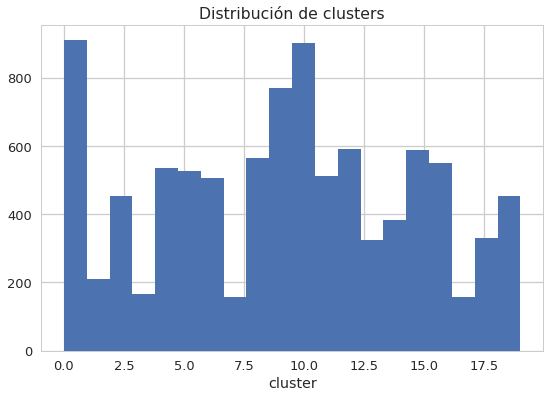

In [44]:
fig, ax = plt.subplots()
df_train['cluster'].hist(bins=20)
ax.set_title(u'Distribución de clusters')
ax.set_xlabel(u'cluster');

El siguiente código muestra 5 imágenes de ejemplo de cada cluster, escogidas al azar:

In [45]:
# Graficar imágenes aleatorias de un cluster
sns.set_style("whitegrid", {'axes.grid' : False})
def plot_all_clusters(df, n_cluster, n_samples, seed=0):
    np.random.seed(seed=seed)
    fig, ax = plt.subplots(figsize = (15, 10))
    df_cluster = df[df.cluster == n_cluster]
    img_idx = np.random.randint(df_cluster.shape[0], size=n_samples)
    imgs_cluster = process_images(df_cluster.iloc[img_idx])
    columns = n_samples
    
    for i, image in enumerate(imgs_cluster):
        plt.subplot(1.0 * len(imgs_cluster) / columns + 1, columns, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.ylabel('cluster {}'.format(n_cluster))
        plt.imshow(image[:,:,::-1]);

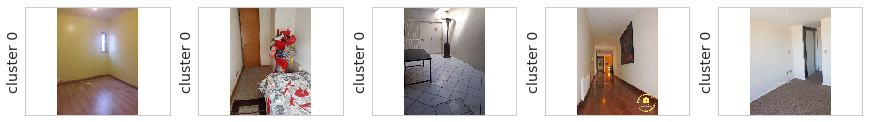

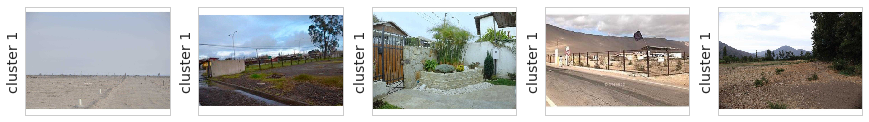

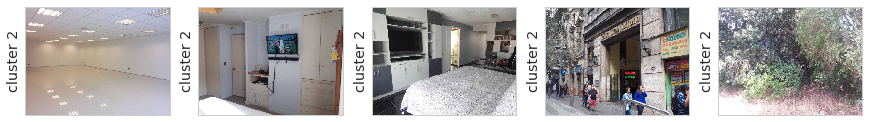

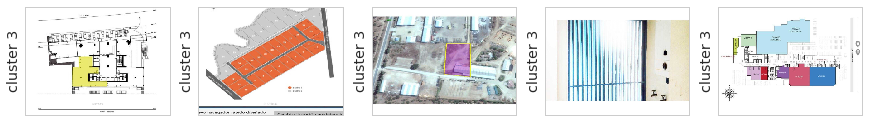

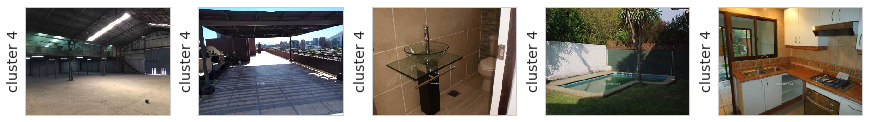

...

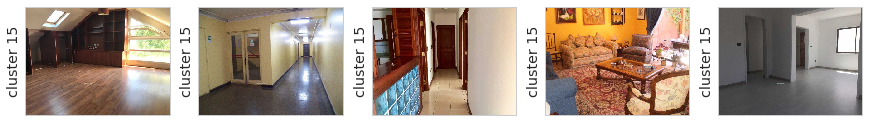

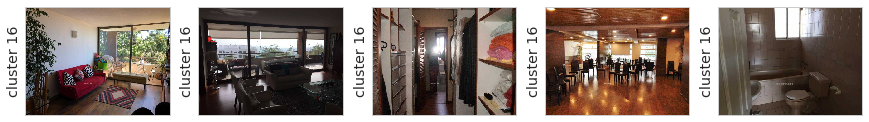

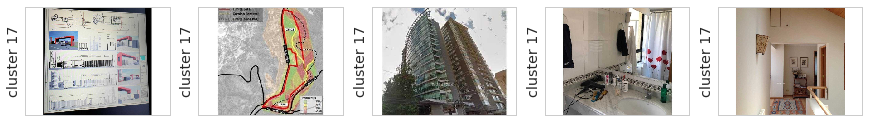

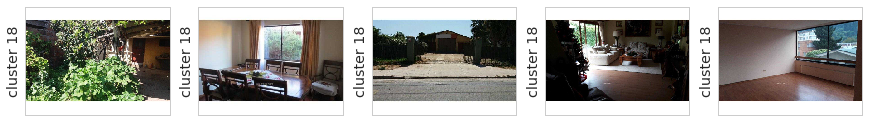

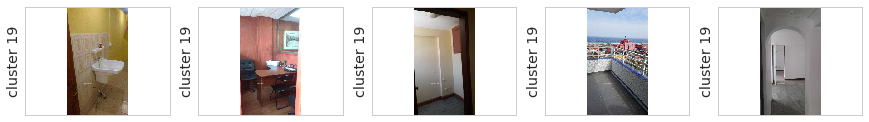

In [46]:
for cluster_idx in range(20):
    plot_all_clusters(df_train, n_cluster=cluster_idx, n_samples=5)

Llama la atención el cluster 3, ya que la mayor parte de las imágenes corresponde a planos. Veamos el cluster en profundidad:

In [70]:
# Mostrar todas las imágenes de un cluster
def plot_cluster(df, n_cluster, columns=6):
    images = process_images(df[df.cluster == n_cluster])
    print("Tamaño del cluster: {}".format(len(images)))

    fig, ax = plt.subplots(figsize = (20, 3*len(images) / columns))
    for i, image in enumerate(images):
        plt.subplot(1.0 * len(images) / columns + 1, columns, i + 1)
        plt.axis('off')
        plt.imshow(image[:,:,::-1])

Tamaño del cluster: 165


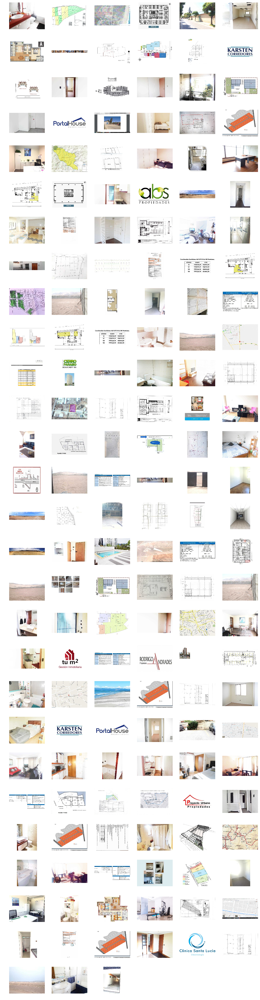

In [71]:
plot_cluster(df_train, n_cluster=3)

Efectivamente, podemos ver que la mayor parte de las imágenes del cluster 3 corresponde a planos, logos de empresas y tablas, todos los cuales tienen en común que su fondo es blanco. Podemos volver a aplicar clustering para separar estas imágenes:

In [73]:
idx = np.flatnonzero(df_train.cluster == 3)
X_encoded_3 = X_encoded[idx]
kmeans_3 = KMeans(n_clusters=8, random_state=0).fit(X_encoded_3)
df_3 = df_train[df_train.cluster == 3]
df_3['cluster'] = kmeans_3.labels_
df_3.head()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


,filename,height,img_format,img_mode,size,width,area,cluster
22,3961694_d0zw4ao02lj.jpg,480,JPEG,RGB,21.957,640,307200,5
41,3898020_o33ttod2fs3.jpg,600,JPEG,RGB,32.807,800,480000,0
85,3796681_rntpt0ioetf.jpg,960,JPEG,RGB,135.298,1280,1228800,7
120,2031882_bfqzwceudtf.jpg,368,JPEG,RGB,32.163,491,180688,7
323,3874545_uruf4m4tfdb.jpg,480,JPEG,RGB,35.672,640,307200,3


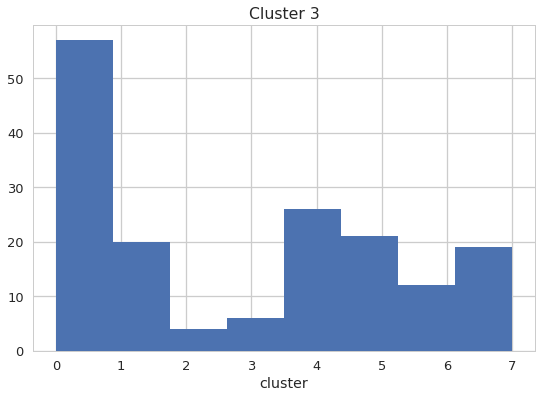

In [78]:
fig, ax = plt.subplots()
df_3['cluster'].hist(bins=8)
ax.set_title(u'Cluster 3')
ax.set_xlabel(u'cluster');

Tamaño del cluster: 57


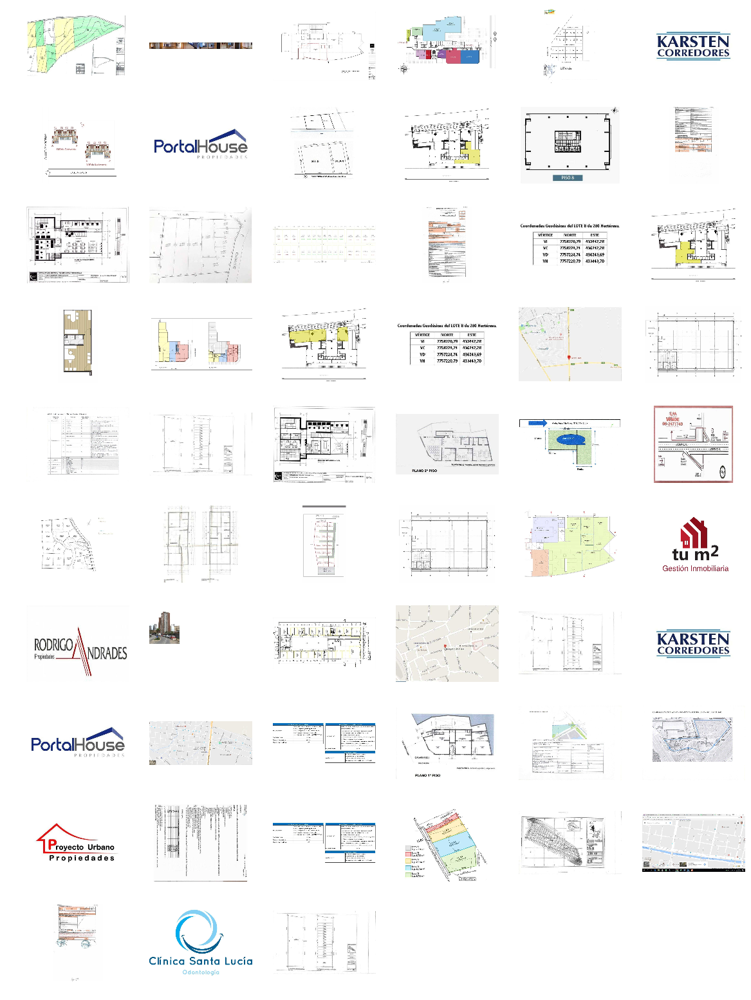

In [77]:
plot_cluster(df_3, n_cluster=0)

Efectivamente, podemos ver que todas las imágenes agrupadas en este cluster corresponden a planos y logos. Estudiemos ahora el cluster 1 del clustering original:

Tamaño del cluster: 211


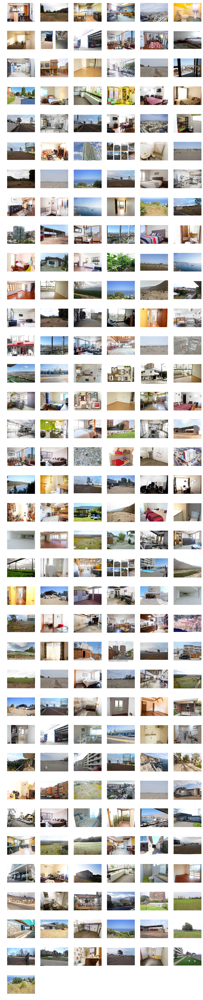

In [72]:
plot_cluster(df_train, n_cluster=1)

Se puede ver que gran parte de la imágenes corresponde a fotos de terrenos. Por este motivo, se realizará clustering nuevamente dentro del cluster 1 para separar las imágenes no deseadas.

In [63]:
idx = np.flatnonzero(df_train.cluster == 1)
X_encoded_1 = X_encoded[idx]
kmeans_1 = KMeans(n_clusters=8, random_state=0).fit(X_encoded_1)
df_1 = df_train[df_train.cluster == 1]
df_1['cluster'] = kmeans_1.labels_
df_1.head()

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


,filename,height,img_format,img_mode,size,width,area,cluster
27,3961679_alxlysxd0cy.jpg,480,JPEG,RGB,26.994,640,307200,5
95,3936125_kgdmodb20yz.jpg,807,JPEG,RGB,90.888,1076,868332,6
133,3959951_3b1zqqb4ep0.jpg,960,JPEG,RGB,96.391,1280,1228800,4
361,3959951_ru3iduixf0q.jpg,960,JPEG,RGB,128.554,1280,1228800,4
475,3950848_ey2doxmicdx.jpg,960,JPEG,RGB,134.926,1280,1228800,5


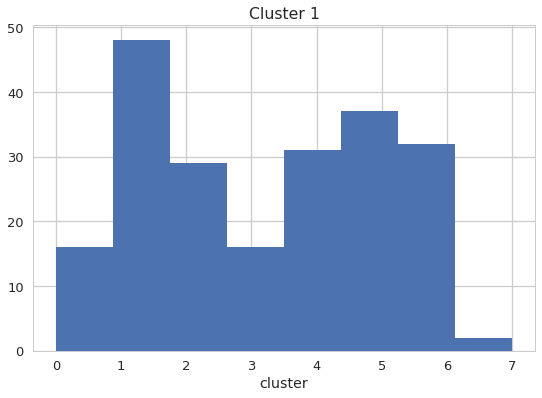

In [79]:
fig, ax = plt.subplots()
df_1['cluster'].hist(bins=8)
ax.set_title(u'Cluster 1')
ax.set_xlabel(u'cluster');

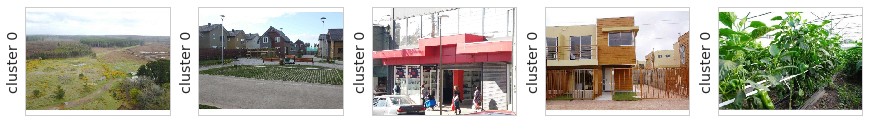

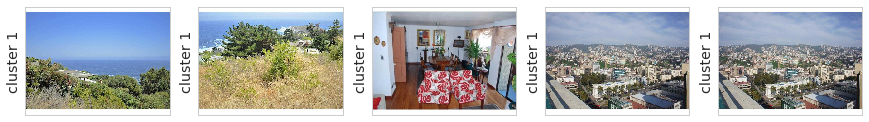

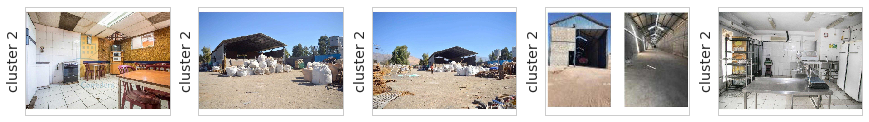

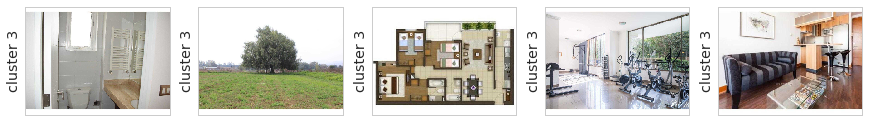

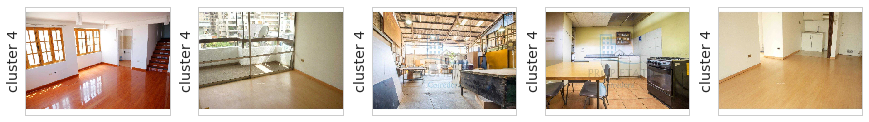

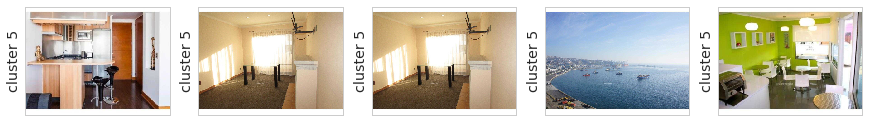

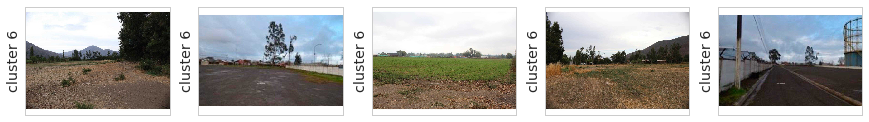

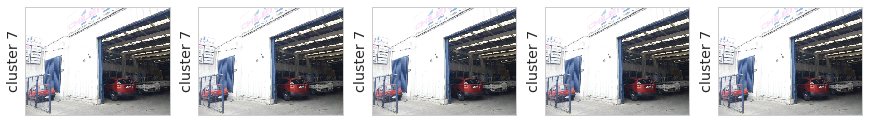

In [64]:
for cluster_idx in range(8):
    plot_all_clusters(df_1, n_cluster=cluster_idx, n_samples=5)

Tamaño del cluster: 32


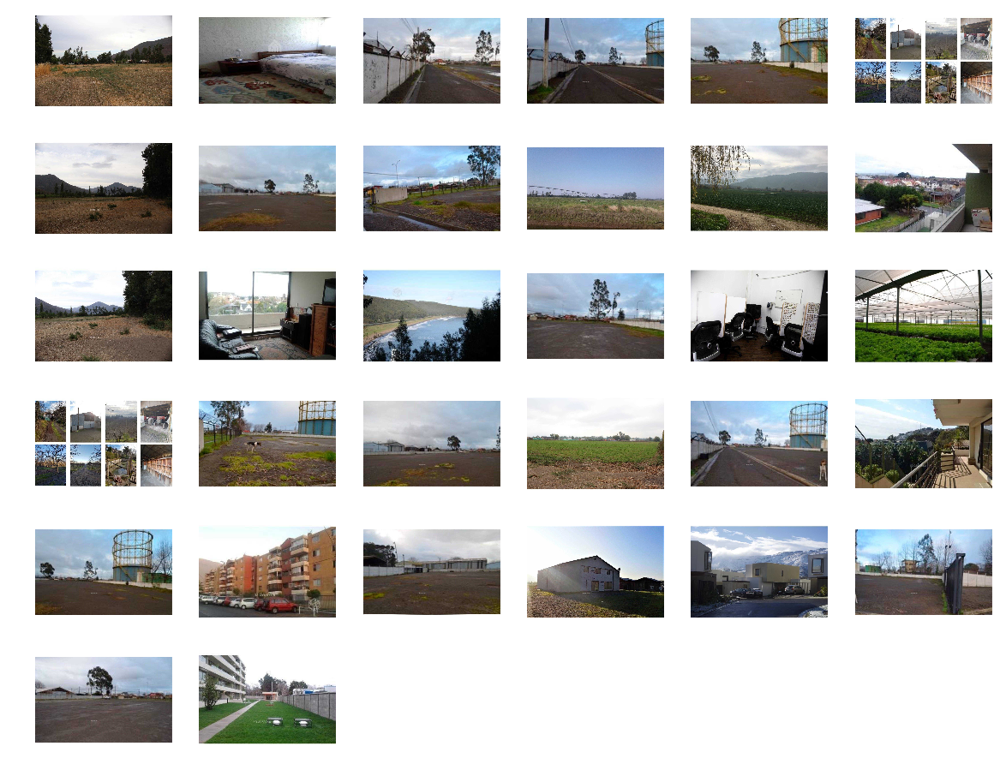

In [76]:
plot_cluster(df_1, n_cluster=6)

Nuevamente podemos ver que, excepto por dos imágenes, todos las fotos agrupadas en este cluster corresponden a paisajes.